<a href="https://colab.research.google.com/github/wxzg7045/A-Parallel-Gumbel-Softmax-VAE-Framework-with-Performance-Based-Tuning/blob/main/A_Parallel_Gumbel_Softmax_VAE_Framework_with_Performance_Based_Tuning_on_CIFAR_10.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

100%|██████████| 170498071/170498071 [00:05<00:00, 28748504.32it/s]


Extracting ./data/cifar-10-python.tar.gz to ./data
Files already downloaded and verified
Train Epoch: 0 	Model: 0 	Training Loss: 7977.347150485534 	Training BPD: 0.9354925204420943
Train Epoch: 0 	Model: 1 	Training Loss: 7972.283678918238 	Training BPD: 0.9349213306556272
Train Epoch: 0 	Model: 2 	Training Loss: 8017.188445342471 	Training BPD: 0.9400979964934346
Train Epoch: 1 	Model: 0 	Training Loss: 7745.8091906769505 	Training BPD: 0.9081788442628768
Train Epoch: 1 	Model: 1 	Training Loss: 7677.484315057544 	Training BPD: 0.9002540911859869
Train Epoch: 1 	Model: 2 	Training Loss: 7726.9750439578 	Training BPD: 0.9060000691877301
Train Epoch: 2 	Model: 0 	Training Loss: 7556.336362092391 	Training BPD: 0.8862080857576922
Train Epoch: 2 	Model: 1 	Training Loss: 7456.756778492647 	Training BPD: 0.8745818853073413
Train Epoch: 2 	Model: 2 	Training Loss: 7459.410389775815 	Training BPD: 0.8748338571594804
Train Epoch: 3 	Model: 0 	Training Loss: 7339.861767703005 	Training BPD: 0

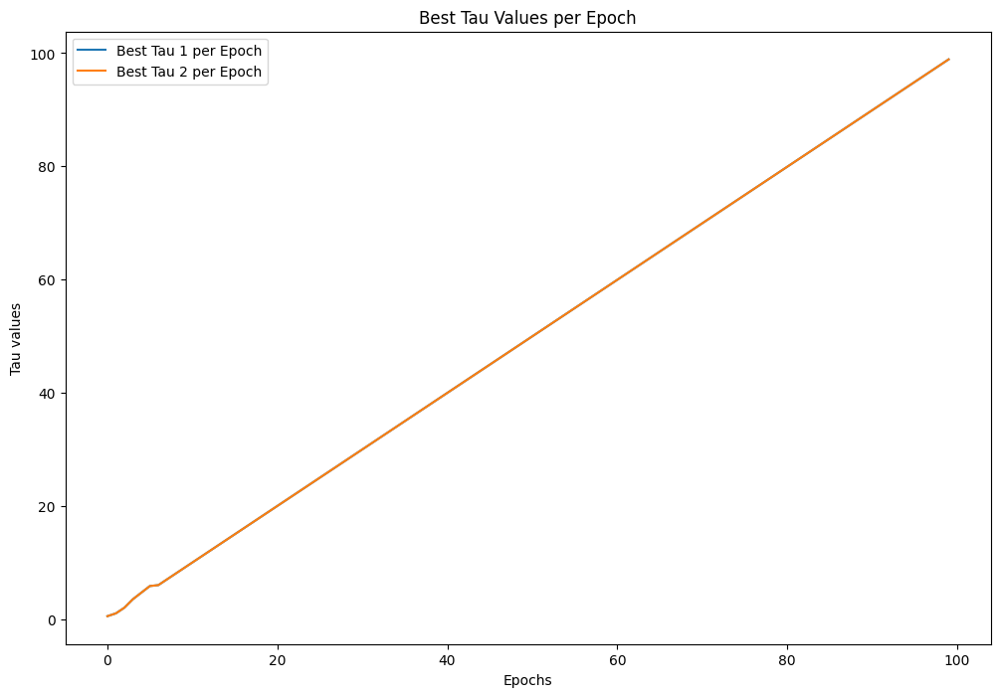

In [ ]:
# Our proposed model using linear increasing tau on CIFAR-10
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import copy
import numpy as np
import os
import torch.nn.functional as F
import torch.utils.data.dataloader as dataloader
import torch.optim as optim
from torch.utils.data import TensorDataset
from torch.autograd import Variable
from torchvision import transforms
from torchvision.datasets import CelebA
from torch import optim
from torch.utils import data as dataloader


# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')

# Define constants
BATCH_SIZE = 128
Z_DIM = 300
LOG_INTERVAL = 50


# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy().squeeze()
    reconstructed_images = reconstructed_images.cpu().detach().numpy().squeeze()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 4 * 4, Z_DIM)
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 4 * 4)
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 8 * 8)

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z


    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 4, 4)  # reshape
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.tanh(self.conv_trans4_1(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 8, 8)  # reshape
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Clamp the values of recon_x between 0 and 1
        recon_x = torch.clamp(recon_x, 0, 1)
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss


initial_tau_1 = 1.0
initial_tau_2 = 1.0
NUM_EPOCHS = 100
LOG_INTERVAL = 50
import numpy as np
NUM_MODELS = 3
import copy
LOSS_THRESHOLD = 0.0001

# Initialize models and optimizers
models = [GumbelSoftmaxVAE().to(device) for _ in range(NUM_MODELS)]
optimizers = [optim.Adam(model.parameters(), lr=1e-3) for model in models]

# Calculate the decay rates for tau_1 and tau_2 for each model
decay_rates_1 = np.linspace(0.999 - (0.5 / NUM_MODELS), 0.999 + (0.5 / NUM_MODELS), NUM_MODELS)
decay_rates_2 = np.linspace(0.999 - (0.5 / NUM_MODELS), 0.999 + (0.5 / NUM_MODELS), NUM_MODELS)

best_tau_per_epoch_1 = []  # To record the best tau_1 for each epoch
best_tau_per_epoch_2 = []  # To record the best tau_2 for each epoch

for epoch in range(NUM_EPOCHS):
    losses = []
    bpds = []
    best_reconstruction = None  # Keep track of the best reconstruction
    original_images = None

    for i in range(NUM_MODELS):
        models[i].tau_1 = nn.Parameter(torch.tensor(max(initial_tau_1 * (decay_rates_1[i] * epoch), 0.5)), requires_grad=True) # linear increasing tau
        models[i].tau_2 = nn.Parameter(torch.tensor(max(initial_tau_2 * (decay_rates_2[i] * epoch), 0.5)), requires_grad=True)

        epoch_loss = 0.0
        epoch_bpd = 0.0

        for batch_idx, (data, _) in enumerate(train_loader):
            data = data.to(device)
            optimizers[i].zero_grad()
            recon_batch, logits_z1, logits_z2, z1, z2 = models[i](data)
            loss = models[i].gumbel_softmax_loss_function(recon_batch, data, logits_z1, logits_z2, z1, z2)
            loss.backward()
            optimizers[i].step()

            epoch_loss += loss.item()

            # Compute the BPD
            xent_loss = F.binary_cross_entropy(recon_batch, data, reduction='none')
            xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])
            bpd = torch.mean(xent_loss) / (3 * 64 * 64 * np.log(2))
            epoch_bpd += bpd.item()

            if epoch_loss < LOSS_THRESHOLD and (best_reconstruction is None or loss.item() < min(losses)):
                best_reconstruction = recon_batch  # Save best reconstruction so far
                original_images = data  # Save the original images for plotting

        # Average loss and BPD over all batches
        epoch_loss /= len(train_loader)
        epoch_bpd /= len(train_loader)

        print(f'Train Epoch: {epoch} \tModel: {i} \tTraining Loss: {epoch_loss} \tTraining BPD: {epoch_bpd}')
        losses.append(epoch_loss)
        bpds.append(epoch_bpd)

    # Select the model with the lowest loss and record the tau
    best_model_idx = np.argmin(losses)
    best_tau_per_epoch_1.append(models[best_model_idx].tau_1.item())
    best_tau_per_epoch_2.append(models[best_model_idx].tau_2.item())

    # Only copy the best model's parameters to all the other models if its loss is below the threshold
    if min(losses) < LOSS_THRESHOLD:
        best_model_state_dict = copy.deepcopy(models[best_model_idx].state_dict())
        for i in range(NUM_MODELS):
            if i != best_model_idx:
                models[i].load_state_dict(best_model_state_dict)
                # Update the tau values as they are not part of the state_dict
                models[i].tau_1 = models[best_model_idx].tau_1
                models[i].tau_2 = models[best_model_idx].tau_2

    # Display the best reconstruction image along with the original image
    if best_reconstruction is not None and original_images is not None:
        plot_images(original_images.cpu(), best_reconstruction.cpu())

# Output the best tau for each epoch
for epoch, (tau_1, tau_2) in enumerate(zip(best_tau_per_epoch_1, best_tau_per_epoch_2)):
    print(f"Epoch: {epoch}, Best Tau 1: {tau_1}, Best Tau 2: {tau_2}")

# Plot the best_tau_per_epoch
plt.figure(figsize=(12, 8))
plt.plot(range(NUM_EPOCHS), best_tau_per_epoch_1, label='Best Tau 1 per Epoch')
plt.plot(range(NUM_EPOCHS), best_tau_per_epoch_2, label='Best Tau 2 per Epoch')
plt.xlabel('Epochs')
plt.ylabel('Tau values')
plt.title('Best Tau Values per Epoch')
plt.legend()
plt.show()

In [ ]:
# The temperature path of our proposed model trained 100 epochs on CIFAR-10
print(best_tau_per_epoch_1)
print(best_tau_per_epoch_2)
best_model = models[best_model_idx]
SAVE_PATH = "/content/best_model_cifar.pt"
torch.save(best_model.state_dict(), SAVE_PATH)

[0.5, 0.999, 1.998, 3.497, 4.6626666666666665, 5.828333333333333, 5.994, 6.993, 7.992, 8.991, 9.99, 10.989, 11.988, 12.987, 13.986, 14.985, 15.984, 16.983, 17.982, 18.981, 19.98, 20.979, 21.978, 22.977, 23.976, 24.975, 25.974, 26.973, 27.972, 28.971, 29.97, 30.969, 31.968, 32.967, 33.966, 34.965, 35.964, 36.963, 37.962, 38.961, 39.96, 40.959, 41.958, 42.957, 43.956, 44.955, 45.954, 46.953, 47.952, 48.951, 49.95, 50.949, 51.948, 52.947, 53.946, 54.945, 55.944, 56.943, 57.942, 58.941, 59.94, 60.939, 61.938, 62.937, 63.936, 64.935, 65.934, 66.933, 67.932, 68.931, 69.93, 70.929, 71.928, 72.927, 73.926, 74.925, 75.924, 76.923, 77.922, 78.921, 79.92, 80.919, 81.918, 82.917, 83.916, 84.915, 85.914, 86.913, 87.912, 88.911, 89.91, 90.909, 91.908, 92.907, 93.906, 94.905, 95.904, 96.903, 97.902, 98.901]
[0.5, 0.999, 1.998, 3.497, 4.6626666666666665, 5.828333333333333, 5.994, 6.993, 7.992, 8.991, 9.99, 10.989, 11.988, 12.987, 13.986, 14.985, 15.984, 16.983, 17.982, 18.981, 19.98, 20.979, 21.978, 2

In [ ]:
# Load our proposed model
SAVE_PATH = "/content/best_model_cifar.pt"

initial_tau_1 = 98.901
initial_tau_2 = 98.901
NUM_EPOCHS = 100
LOG_INTERVAL = 50
import numpy as np
NUM_MODELS = 3
import copy
LOSS_THRESHOLD = 0.0001


model = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model.load_state_dict(state_dict)

model.tau_1 = 98.901
model.tau_2 = 98.901

model.to(device)
model.eval()

Files already downloaded and verified
Files already downloaded and verified


GumbelSoftmaxVAE(
  (conv1): Conv2d(3, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv2): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv3): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv4): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (fc_logits_z1): Linear(in_features=4096, out_features=300, bias=True)
  (fc_logits_z2): Linear(in_features=300, out_features=300, bias=True)
  (fc_dec1): Linear(in_features=300, out_features=4096, bias=True)
  (fc_dec2): Linear(in_features=300, out_features=8192, bias=True)
  (conv_trans1_1): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans2_1): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans3_1): ConvTranspose2d(64, 32, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans4_1): ConvTranspose2d(32, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
  (conv_trans1_2)

Files already downloaded and verified
Files already downloaded and verified


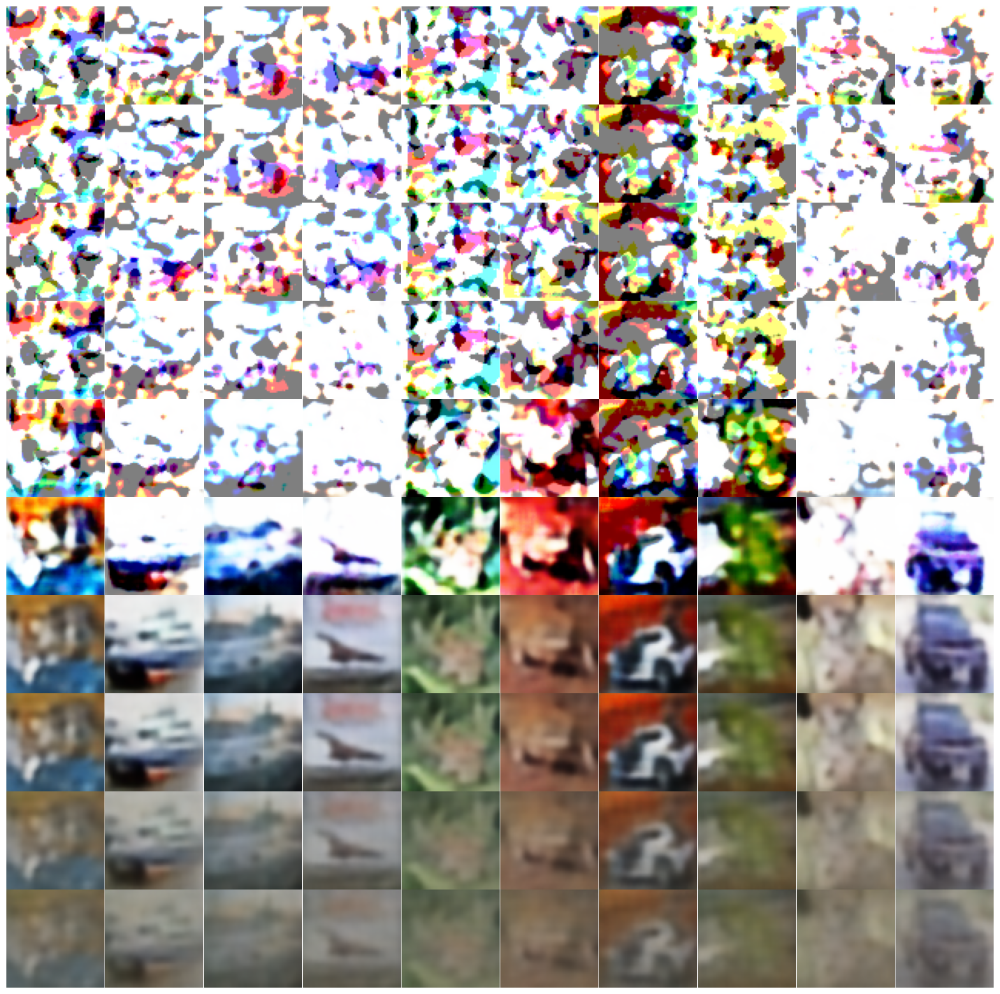

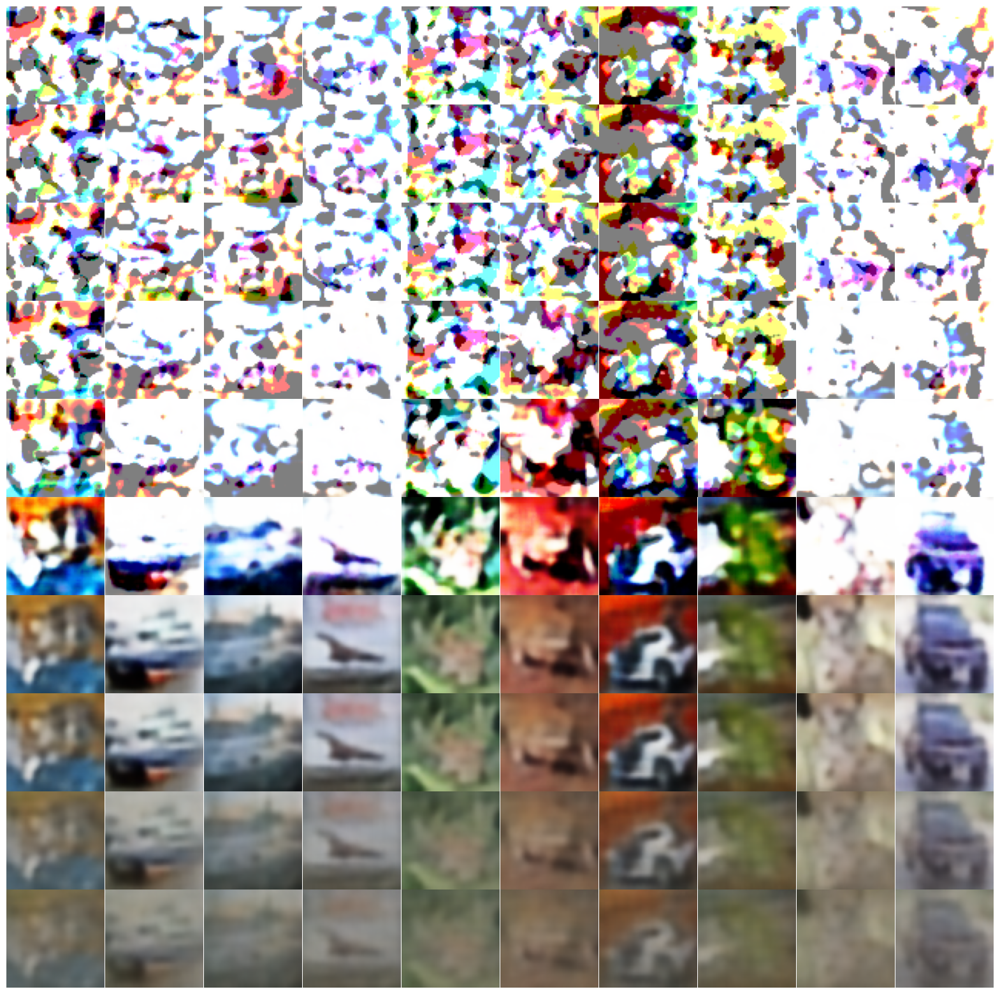

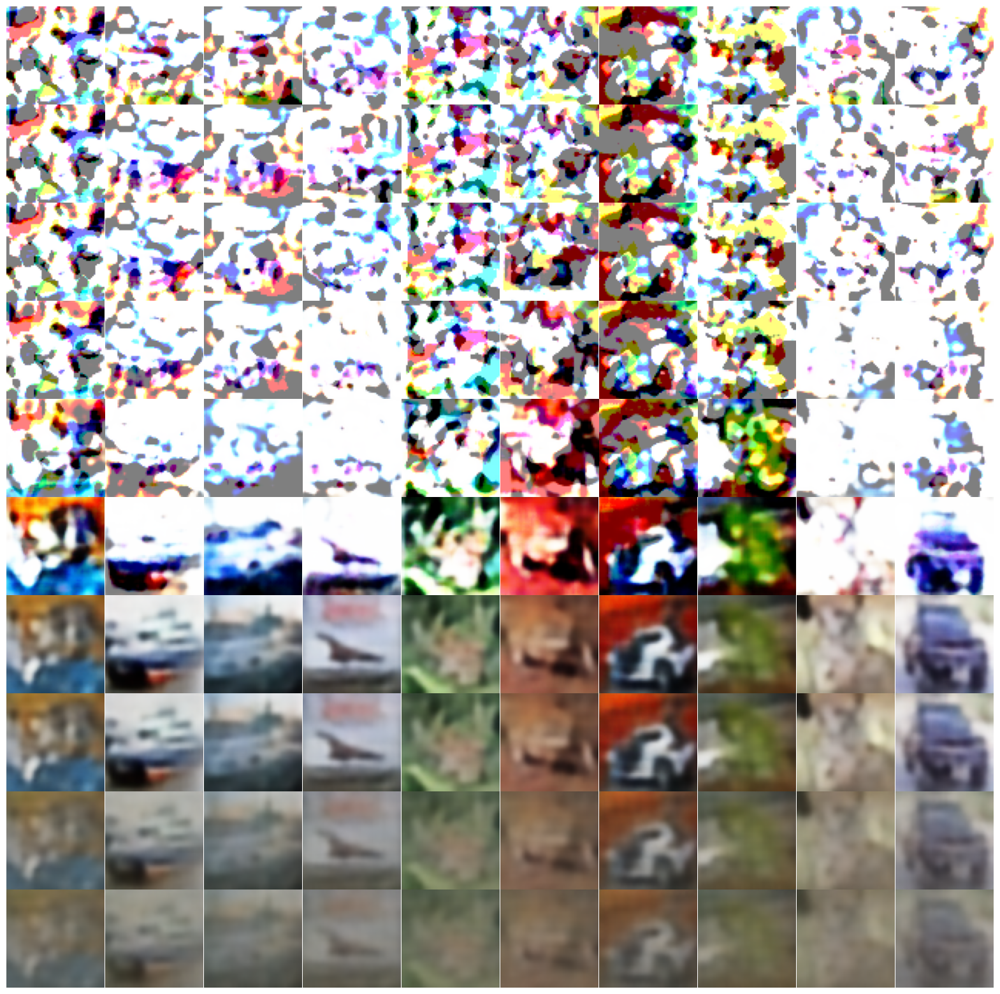

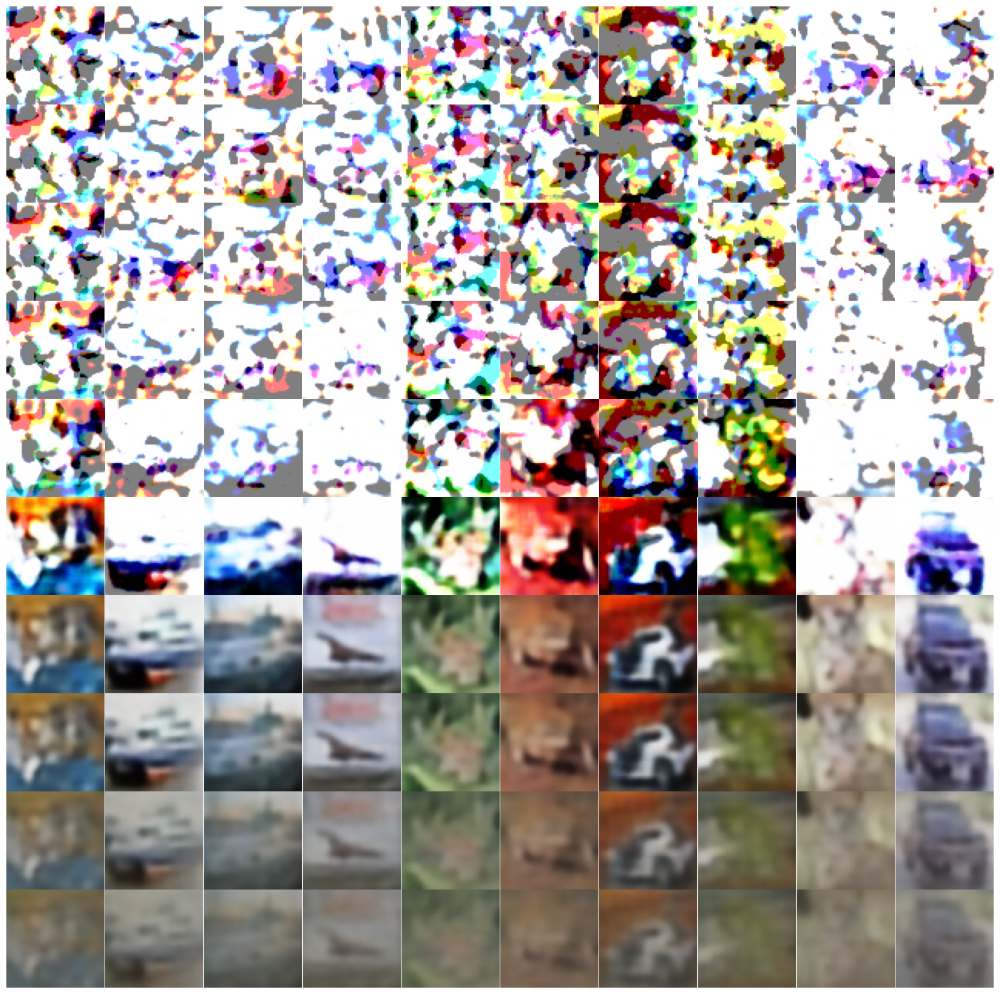

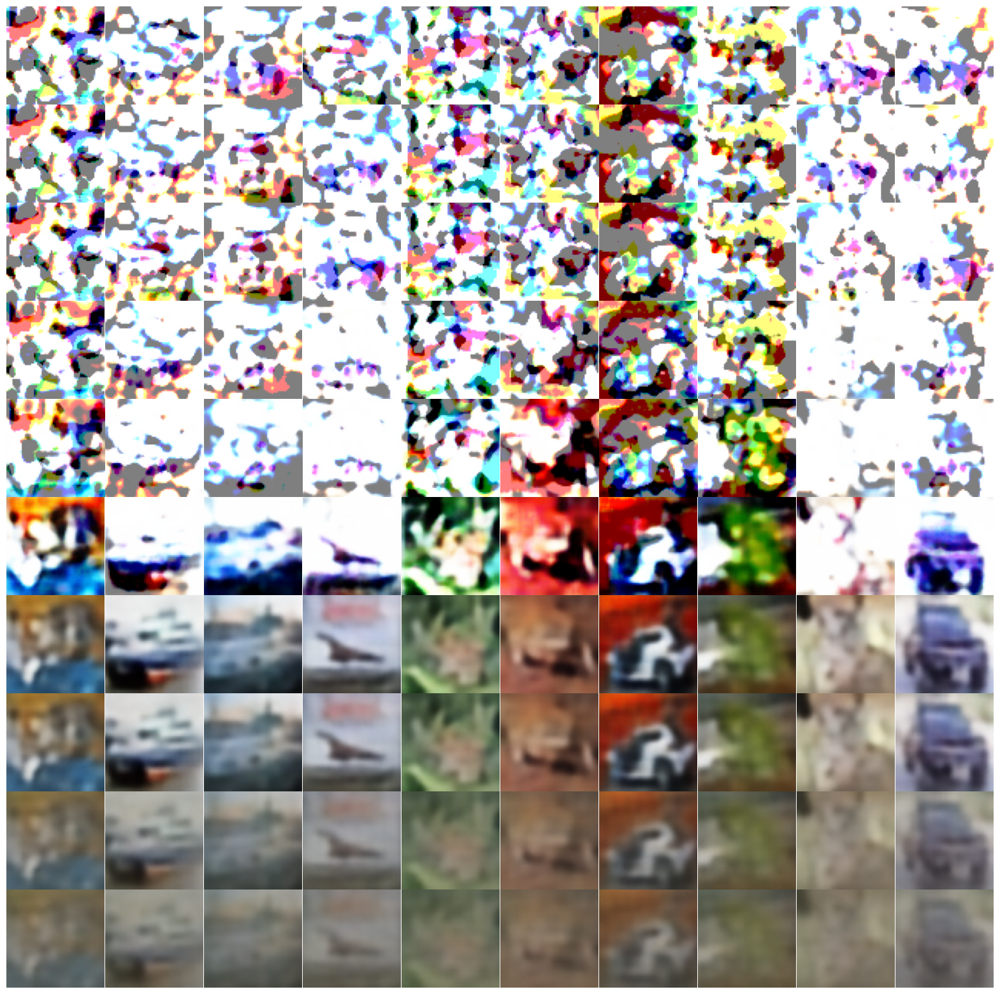

KeyboardInterrupt: 

In [ ]:
# Observe the impact of temperature on the model
import torch
import matplotlib.pyplot as plt
from torchvision import datasets, transforms

# Function to plot reconstructed images in one large figure
def plot_all_reconstructed_images(tau_values, test_loader, model, device, n=10):
    fig, axes = plt.subplots(len(tau_values), n, figsize=(20, 2 * len(tau_values)))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots

    for row, tau in enumerate(tau_values):
        model.tau_1 = tau
        model.tau_2 = tau
        data, _ = next(iter(test_loader))
        data = data.to(device)
        recon_batch, _, _, _, _ = model(data)
        reconstructed_images = recon_batch.cpu().detach().numpy()

        for col in range(n):
            ax = axes[row, col]
            ax.imshow(np.transpose(reconstructed_images[col], (1, 2, 0)))
            ax.axis('off')  # Hide axes

    plt.show()


# Load GumbelSoftmaxVAE model
model = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model.load_state_dict(state_dict)
model.to(device)
model.eval()

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Create data loaders
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


# Tau values to test
tau_values = [0.5, 0.9, 0.95, 5, 10, 30, 98.901, 120, 200, 300]

# Iterate over tau values, update model, and plot reconstructed images
for tau in tau_values:
    model.tau_1 = tau
    model.tau_2 = tau
    data, _ = next(iter(test_loader))
    data = data.to(device)
    recon_batch, _, _, _, _ = model(data)
     # Only plot reconstructed images
    plot_all_reconstructed_images(tau_values, test_loader, model, device)


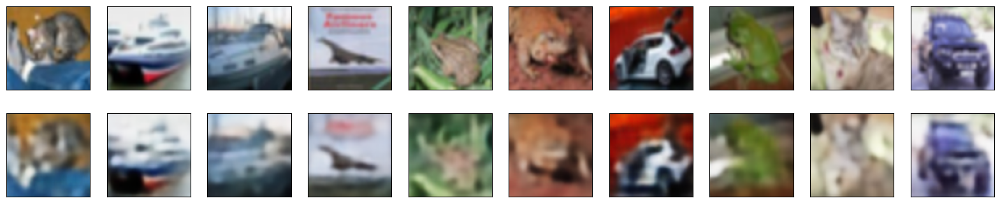

In [ ]:
# Our model reconstruction by using linear increasing tau on CIFAR-10
def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()


# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = model(data)
plot_images(data.cpu(), recon_batch.cpu())



MSE Loss: 0.0012209202395752072


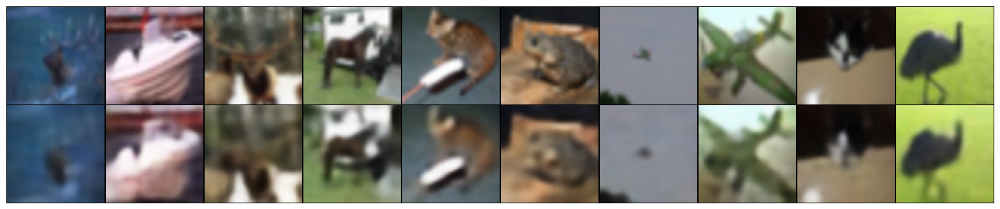

Pixel Error: 2.452065423130989%


In [ ]:
# Test our proposed model's MSE on CIFAR-10
import torch
import torch.nn.functional as F
import matplotlib.pyplot as plt
from torchvision.utils import make_grid
import numpy as np

# Function to calculate MSE loss
def calculate_mse(original, reconstructed):
    mse_loss = F.mse_loss(reconstructed, original, reduction='mean')
    return mse_loss.item()

# Function to calculate FID score
def calculate_fid(real_features, fake_features):
    mu1, mu2 = np.mean(real_features, axis=0), np.mean(fake_features, axis=0)
    sigma1, sigma2 = np.cov(real_features, rowvar=False), np.cov(fake_features, rowvar=False)
    diff = np.sum((mu1 - mu2) ** 2.0)
    covmean = np.linalg.sqrt(sigma1.dot(sigma2))
    fid = diff + np.trace(sigma1 + sigma2 - 2.0 * covmean)
    return fid

# Function to calculate pixel error
def calculate_pixel_error(original, reconstructed):
    pixel_error = torch.mean(torch.abs(original - reconstructed)).item()
    return pixel_error * 100  # Convert to percentage

# Function to plot images without white spaces
def plot_images(original_images, reconstructed_images, n=15):
    # Convert tensors to numpy arrays
    original_images_np = original_images.cpu().numpy()
    reconstructed_images_np = reconstructed_images.cpu().detach().numpy()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Plot original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(np.transpose(original_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Plot reconstructed images
        ax = plt.subplot(2, n, i + n + 1)
        plt.imshow(np.transpose(reconstructed_images_np[i], (1, 2, 0)))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0, hspace=0)
    plt.show()


data, _ = next(iter(test_loader))
data = data.to(device)

# Randomly select n images
indices = torch.randperm(len(data))[:15]
selected_data = data[indices]

# Pass the images through the model
recon_batch, _, _, _, _ = model(selected_data)

# Calculate MSE
mse_loss = calculate_mse(selected_data, recon_batch)
print(f'MSE Loss: {mse_loss}')

# Plot the original and reconstructed images
plot_images(selected_data.cpu(), recon_batch.cpu(), n=10)

# Calculate pixel error
pixel_error = calculate_pixel_error(selected_data, recon_batch)
print(f'Pixel Error: {pixel_error}%')


In [ ]:
# Load trained models
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
import torchvision.datasets as datasets
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
import numpy as np
import copy
import os
import torch.nn.functional as F
import torch.utils.data.dataloader as dataloader
from torch.utils.data import TensorDataset
from torch.autograd import Variable
from torchvision import transforms
from torchvision.datasets import CelebA
from torch.utils import data as dataloader
from torchvision import transforms
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms

# Set the random seed and device
SEED = 1
torch.manual_seed(SEED)
cuda = torch.cuda.is_available()
device = torch.device('cuda' if cuda else 'cpu')

# Define constants
BATCH_SIZE = 128
Z_DIM = 300
LOG_INTERVAL = 50

# Define the transform for image preprocessing
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Helper function to filter out class 1
def remove_class_1(dataset):
    indices = [i for i, (_, label) in enumerate(dataset) if label != 1]
    subset = Subset(dataset, indices)
    return subset

# Download and load the CIFAR-10 dataset
train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Remove class 1 from the training dataset
train_dataset_filtered = remove_class_1(train_dataset)

# Create data loaders
train_loader = DataLoader(train_dataset_filtered, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)


def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy().squeeze()
    reconstructed_images = reconstructed_images.cpu().detach().numpy().squeeze()

    plt.figure(figsize=(20, 4))
    for i in range(n):
        # Display original images
        ax = plt.subplot(2, n, i + 1)
        plt.imshow(original_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        # Display reconstruction images
        ax = plt.subplot(2, n, i + 1 + n)
        plt.imshow(reconstructed_images[i], cmap='gray')
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)
    plt.show()



# Define the GumbelSoftmaxVAE model
class GumbelSoftmaxVAE(nn.Module):
    def __init__(self, tau_1=1.0, tau_2=1.0):
        super().__init__()

        self.tau_1 = tau_1
        self.tau_2 = tau_2

        # Encoder
        self.conv1 = nn.Conv2d(3, 32, kernel_size=4, stride=2, padding=1)
        self.conv2 = nn.Conv2d(32, 64, kernel_size=4, stride=2, padding=1)
        self.conv3 = nn.Conv2d(64, 128, kernel_size=4, stride=2, padding=1)
        self.conv4 = nn.Conv2d(128, 256, kernel_size=4, stride=2, padding=1)

        # Two layers of latent variables
        self.fc_logits_z1 = nn.Linear(256 * 4 * 4, Z_DIM)
        self.fc_logits_z2 = nn.Linear(Z_DIM, Z_DIM)

        # Decoder for each layer
        self.fc_dec1 = nn.Linear(Z_DIM, 256 * 4 * 4)
        self.fc_dec2 = nn.Linear(Z_DIM, 128 * 8 * 8)

        self.conv_trans1_1 = nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_1 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_1 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans4_1 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

        self.conv_trans1_2 = nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1)
        self.conv_trans2_2 = nn.ConvTranspose2d(64, 32, kernel_size=4, stride=2, padding=1)
        self.conv_trans3_2 = nn.ConvTranspose2d(32, 3, kernel_size=4, stride=2, padding=1)

    def encode(self, x):
        x = F.relu(self.conv1(x))
        x = F.relu(self.conv2(x))
        x = F.relu(self.conv3(x))
        x = F.relu(self.conv4(x))
        x = x.view(x.size(0), -1)

        logits_z1 = self.fc_logits_z1(x)
        logits_z2 = self.fc_logits_z2(logits_z1)

        return logits_z1, logits_z2

    def reparameterize(self, logits, tau):
        gumbel_noise = torch.rand_like(logits).to(device)
        gumbel_noise = -torch.log(-torch.log(gumbel_noise + 1e-8) + 1e-8)
        z = (logits + gumbel_noise) / tau
        z = F.softmax(z, dim=-1)
        return z


    def decode1(self, z):
        z = self.fc_dec1(z)
        z = z.view(z.size(0), 256, 4, 4)  # reshape
        z = F.relu(self.conv_trans1_1(z))
        z = F.relu(self.conv_trans2_1(z))
        z = F.relu(self.conv_trans3_1(z))
        z = torch.tanh(self.conv_trans4_1(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def decode2(self, z):
        z = self.fc_dec2(z)
        z = z.view(z.size(0), 128, 8, 8)  # reshape
        z = F.relu(self.conv_trans1_2(z))
        z = F.relu(self.conv_trans2_2(z))
        z = torch.sigmoid(self.conv_trans3_2(z))
        z = torch.clamp(z, 0, 1)  # Clamp the values between 0 and 1
        return z

    def forward(self, x):
        logits_z1, logits_z2 = self.encode(x)
        z1 = self.reparameterize(logits_z1, self.tau_1)
        z2 = self.reparameterize(logits_z2, self.tau_2)

        x_hat1 = self.decode1(z1)
        x_hat2 = self.decode2(z2)

        # Average the output of the two decoders
        x_hat = (x_hat1 + x_hat2) / 2.0

        return x_hat, logits_z1, logits_z2, z1, z2

    def gumbel_softmax_loss_function(self, recon_x, x, logits_z1, logits_z2, z1, z2):
        # Clamp the values of recon_x between 0 and 1
        recon_x = torch.clamp(recon_x, 0, 1)
        # Binary cross entropy
        xent_loss = F.binary_cross_entropy(recon_x, x, reduction='none')
        xent_loss = torch.sum(xent_loss, dim=[1, 2, 3])

        # KL divergence for each layer
        p_z1 = F.softmax(logits_z1, dim=-1)
        p_z1 = torch.clamp(p_z1, torch.finfo(p_z1.dtype).eps, 1. - torch.finfo(p_z1.dtype).eps)  # to prevent log(0)
        kl_loss_z1 = torch.sum(p_z1 * torch.log(p_z1 * Z_DIM + torch.finfo(p_z1.dtype).eps), dim=-1)

        p_z2 = F.softmax(logits_z2, dim=-1)
        p_z2 = torch.clamp(p_z2, torch.finfo(p_z2.dtype).eps, 1. - torch.finfo(p_z2.dtype).eps)  # to prevent log(0)
        kl_loss_z2 = torch.sum(p_z2 * torch.log(p_z2 * Z_DIM + torch.finfo(p_z2.dtype).eps), dim=-1)

        # Total loss is the sum of the losses for each layer
        vae_loss = torch.mean(xent_loss + kl_loss_z1 + kl_loss_z2)
        return vae_loss



SAVE_PATH = "/content/sample_data/best_model_cifar_anomaly_v1.pt" # The GS-VAE model was trained by the dataset without class automobile by using a linear increasing temperature strategy
SAVE_PATH1 = "/content/sample_data/best_model_cifar_anomaly_our_m1.pt"  # The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework
SAVE_PATH2 = "/content/sample_data/best_model_cifar_anomaly_regular.pt" # The GS-VAE model was trained by dataset without class automobile by using regular decay temperature strategy
SAVE_PATH3 = "/content/sample_data/best_model_cifar_full_our_m1.pt" # The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework


initial_tau_1 = 98.901
initial_tau_2 = 98.901
NUM_EPOCHS = 100
LOG_INTERVAL = 50
import numpy as np
NUM_MODELS = 10
import copy
LOSS_THRESHOLD = 0.0001

# The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework (using different changing rate with model)
model1 = GumbelSoftmaxVAE()
state_dict1 = torch.load(SAVE_PATH1, map_location=device)
state_dict1.pop('tau_1', None)
state_dict1.pop('tau_2', None)
model1.load_state_dict(state_dict1)

model1.tau_1 = 49.401
model1.tau_2 = 49.401

model1.to(device)
model1.eval()

# The GS-VAE model was trained by dataset without class automobile by using regular decay temperature strategy
model2 = GumbelSoftmaxVAE()
state_dict2 = torch.load(SAVE_PATH2, map_location=device)
state_dict2.pop('tau_1', None)
state_dict2.pop('tau_2', None)
model2.load_state_dict(state_dict2)

model2.tau_1 = 0.5
model2.tau_2 = 0.5

model2.to(device)
model2.eval()

# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
model3 = GumbelSoftmaxVAE()
state_dict3 = torch.load(SAVE_PATH3, map_location=device)
state_dict3.pop('tau_1', None)
state_dict3.pop('tau_2', None)
model3.load_state_dict(state_dict3)

model3.tau_1 = 49.401
model3.tau_2 = 49.401

model3.to(device)
model3.eval()

# The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework
model = GumbelSoftmaxVAE()
state_dict = torch.load(SAVE_PATH, map_location=device)
state_dict.pop('tau_1', None)
state_dict.pop('tau_2', None)
model.load_state_dict(state_dict)

model.tau_1 = 82.40100000000001
model.tau_2 = 82.40100000000001

model.to(device)
model.eval()



Files already downloaded and verified
Files already downloaded and verified


FileNotFoundError: [Errno 2] No such file or directory: '/content/sample_data/best_model_cifar_full_our_m1.pt'

Files already downloaded and verified


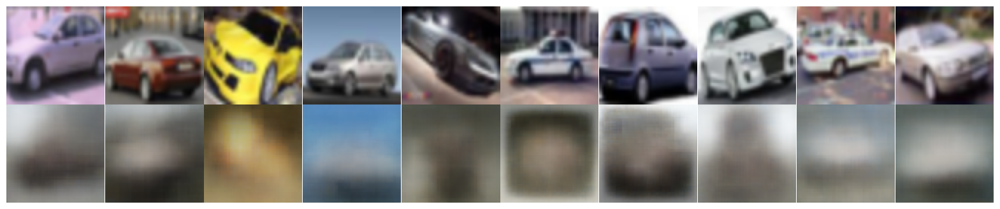

In [ ]:
# The GS-VAE model was trained by dataset without class automobile by using regular decay temperature strategy
# To reconstruct the unseen class "automobile" (class 1)
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])


test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Filter out class 1 from the test dataset
class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 1]
class_1_dataset = Subset(test_dataset, class_1_indices)

# Create a data loader for class 1 only
class_1_loader = DataLoader(class_1_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)
    for i in range(n):
        # Display original images
        ax = axes[0, i]
        ax.imshow(original_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes

        # Display reconstructed images
        ax = axes[1, i]
        ax.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes
    plt.show()


# Choose a random batch of class 1 images from the test dataset
data, _ = next(iter(class_1_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = model2(data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu())


Files already downloaded and verified


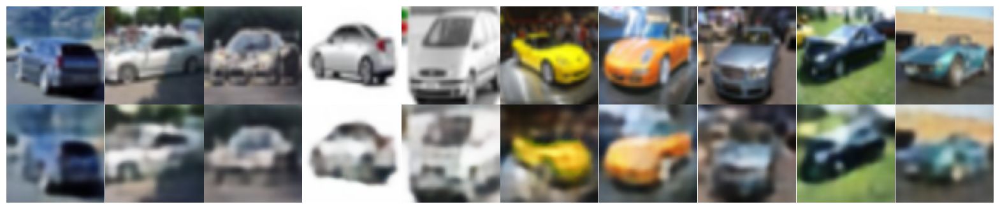

In [ ]:
# The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework
# To reconstruct the unseen class "automobile" (class 1)
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 1]
class_1_dataset = Subset(test_dataset, class_1_indices)

# Create a data loader for class 1 only
class_1_loader = DataLoader(class_1_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def plot_images(original_images, reconstructed_images, n=10):
    original_images = original_images.cpu().numpy()
    reconstructed_images = reconstructed_images.cpu().detach().numpy()
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        ax = axes[0, i]
        ax.imshow(original_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes

        # Display reconstructed images
        ax = axes[1, i]
        ax.imshow(reconstructed_images[i].transpose(1, 2, 0))
        ax.axis('off')  # Hide axes
    plt.show()


data, _ = next(iter(class_1_loader))
data = data.to(device)

# Pass the images through the best model
recon_batch, _, _, _, _ = model(data)

# Plot the original and reconstructed images
plot_images(data.cpu(), recon_batch.cpu())


Files already downloaded and verified


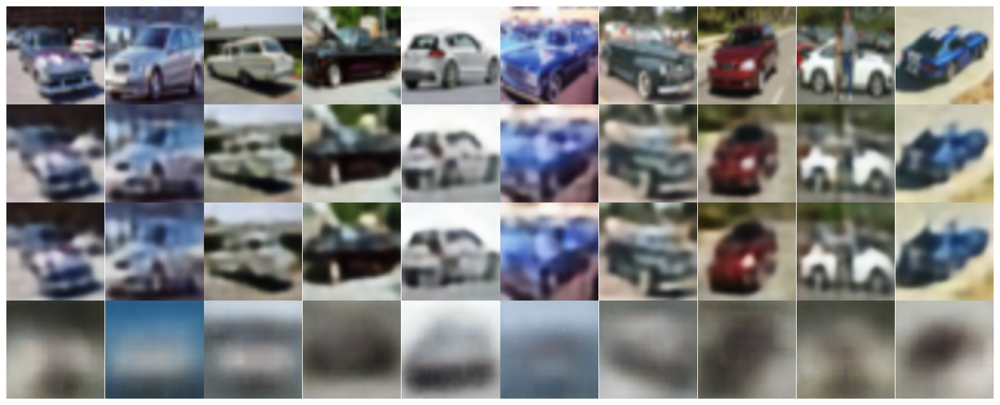

In [ ]:
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

# Filter out class 1 from the test dataset
class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label == 1]
class_1_dataset = Subset(test_dataset, class_1_indices)

# Create a data loader for class 1 only
class_1_loader = DataLoader(class_1_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

# Define a function to plot images for comparison
def plot_comparison(original_images, recon_images_model, recon_images_model1, recon_images_model2, n=10):
    fig, axes = plt.subplots(4, n, figsize=(20, 8))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        axes[0, i].imshow(np.transpose(original_images[i], (1, 2, 0)))
        axes[0, i].axis('off')  # Hide axes

        # Display reconstructed images from model
        axes[1, i].imshow(np.transpose(recon_images_model[i], (1, 2, 0)))
        axes[1, i].axis('off')  # Hide axes

        # Display reconstructed images from model1
        axes[2, i].imshow(np.transpose(recon_images_model1[i], (1, 2, 0)))
        axes[2, i].axis('off')  # Hide axes

        # Display reconstructed images from model2
        axes[3, i].imshow(np.transpose(recon_images_model2[i], (1, 2, 0)))
        axes[3, i].axis('off')  # Hide axes
    plt.show()


# Choose a random batch of class 1 images from the test dataset
data, _ = next(iter(class_1_loader))
data = data.to(device)

# Pass the images through each model
with torch.no_grad():
    recon_batch_model = model(data)[0]
    recon_batch_model1 = model1(data)[0]
    recon_batch_model2 = model2(data)[0]

# Plot the original and reconstructed images
original_images = data.cpu().numpy()
recon_images_model = recon_batch_model.cpu().numpy() # The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework (using different changing rate with model 1)
recon_images_model1 = recon_batch_model1.cpu().numpy() # The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework
recon_images_model2 = recon_batch_model2.cpu().numpy() # The GS-VAE model was trained by dataset without class automobile by using regular decay temperature strategy

# Call the plotting function
plot_comparison(original_images, recon_images_model, recon_images_model1, recon_images_model2, n=10)


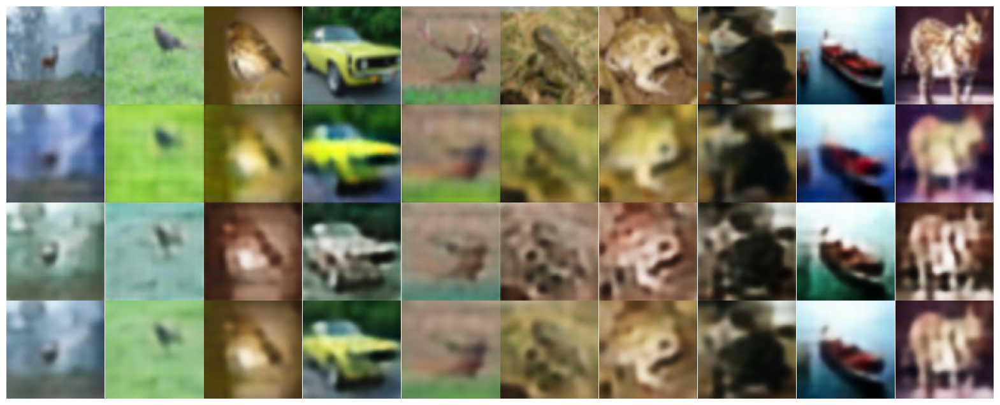

In [ ]:
# The GS-VAE model was trained by the dataset without class automobile by using parallel temperature adjustment framework
# Test each latent layer's contribution

def plot_images_from_layers_and_reconstruction(data, model):
    with torch.no_grad():  # Ensure we're in no_grad mode when doing inference
        logits_z1, logits_z2 = model.encode(data)
        z1 = model.reparameterize(logits_z1, model.tau_1)
        z2 = model.reparameterize(logits_z2, model.tau_2)
        recon_images_layer1 = model.decode1(z1)
        recon_images_layer2 = model.decode2(z2)
        # Combine the layers to create the final reconstruction
        final_reconstruction = (recon_images_layer1 + recon_images_layer2) / 2.0

        # Plot images
        fig, axes = plt.subplots(4, 10, figsize=(20, 8))
        plt.subplots_adjust(wspace=0, hspace=0)  # Remove whitespace

        for i in range(10):
            # Original images
            axes[0, i].imshow(data[i].cpu().permute(1, 2, 0))
            axes[0, i].axis('off')
            # Reconstructed images from layer 1
            axes[1, i].imshow(recon_images_layer1[i].cpu().permute(1, 2, 0))
            axes[1, i].axis('off')
            # Reconstructed images from layer 2
            axes[2, i].imshow(recon_images_layer2[i].cpu().permute(1, 2, 0))
            axes[2, i].axis('off')
            # Final reconstructed images
            axes[3, i].imshow(final_reconstruction[i].cpu().permute(1, 2, 0))
            axes[3, i].axis('off')

        plt.show()

plot_images_from_layers_and_reconstruction(data, model)

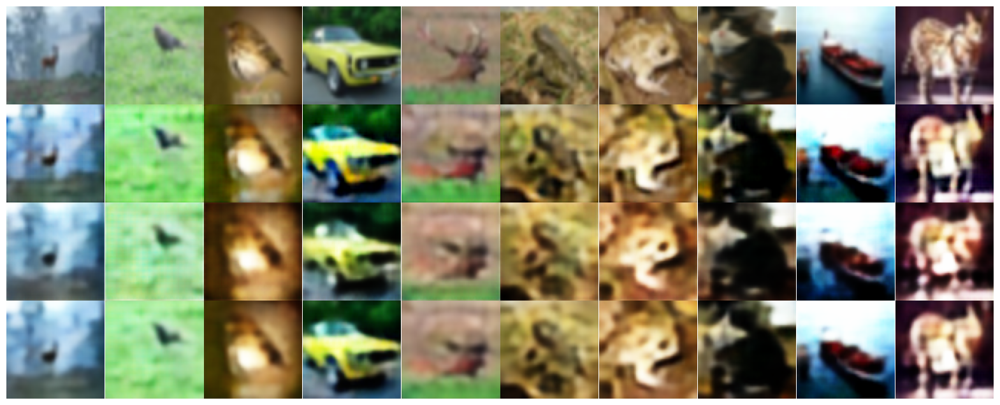

In [ ]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test each latent layer's contribution
def plot_images_from_layers_and_reconstruction(data, model):
    with torch.no_grad():  # Ensure we're in no_grad mode when doing inference
        logits_z1, logits_z2 = model.encode(data)
        z1 = model.reparameterize(logits_z1, model.tau_1)
        z2 = model.reparameterize(logits_z2, model.tau_2)
        recon_images_layer1 = model.decode1(z1)
        recon_images_layer2 = model.decode2(z2)
        # Combine the layers to create the final reconstruction
        final_reconstruction = (recon_images_layer1 + recon_images_layer2) / 2.0

        fig, axes = plt.subplots(4, 10, figsize=(20, 8))
        plt.subplots_adjust(wspace=0, hspace=0)  # Remove whitespace

        for i in range(10):
            # Original images
            axes[0, i].imshow(data[i].cpu().permute(1, 2, 0))
            axes[0, i].axis('off')
            # Reconstructed images from layer 1
            axes[1, i].imshow(recon_images_layer1[i].cpu().permute(1, 2, 0))
            axes[1, i].axis('off')
            # Reconstructed images from layer 2
            axes[2, i].imshow(recon_images_layer2[i].cpu().permute(1, 2, 0))
            axes[2, i].axis('off')
            # Final reconstructed images
            axes[3, i].imshow(final_reconstruction[i].cpu().permute(1, 2, 0))
            axes[3, i].axis('off')

        plt.show()

plot_images_from_layers_and_reconstruction(data, model3)


Files already downloaded and verified
Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.02


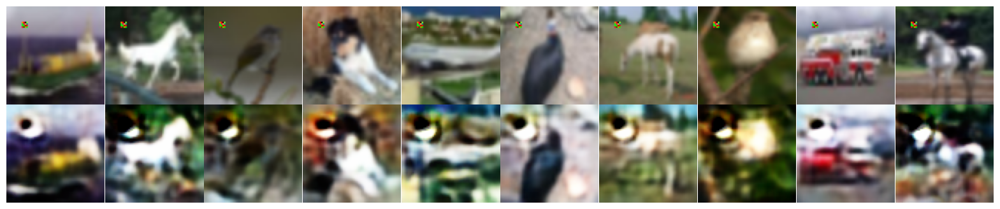

In [ ]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test the model for detecting the small-scale patch
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation and download CIFAR-10 test dataset
transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

# Function to add Gaussian noise (do not use in this cell)
def add_gaussian_noise(images, mean=0.0, std=0.0):
    return images + torch.randn_like(images) * std + mean

# Function to add an adversarial patch
def add_adversarial_patch(images, patch_size=(4, 4), start_x=10, start_y=10):
    patched_images = images.clone()
    patch = torch.randn((3, patch_size[0], patch_size[1]))  # Change the order of dimensions
    for img in patched_images:
        img[:, start_y:start_y+patch_size[1], start_x:start_x+patch_size[0]] = patch
    return patched_images

import matplotlib.pyplot as plt
import numpy as np

def plot_images(original_images, reconstructed_images, n=10):
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)

    for i in range(n):
        # Display original images
        ax = axes[0, i]
        original_img = np.transpose(original_images[i].numpy(), (1, 2, 0))
        ax.imshow(original_img, cmap='gray')
        ax.axis('off')

        # Display reconstructed images
        ax = axes[1, i]
        recon_img = np.transpose(reconstructed_images[i].detach().numpy(), (1, 2, 0))  # Use detach() here
        ax.imshow(recon_img, cmap='gray')
        ax.axis('off')

    plt.show()

# Choose a random batch of images from the test dataset
data, _ = next(iter(test_loader))
data = data.to(device)

# Add Gaussian noise and adversarial patch
noisy_data = add_gaussian_noise(data)
patched_data = add_adversarial_patch(noisy_data)

# Pass the images through the model
recon_batch = model3(patched_data)[0]

# Function to calculate reconstruction error
def calculate_reconstruction_error(data, recon_data):
    return F.mse_loss(recon_data, data, reduction='none').mean([1, 2, 3])

# Calculate reconstruction errors
reconstruction_errors = calculate_reconstruction_error(patched_data, recon_batch)
reconstruction_errors = reconstruction_errors.detach().cpu().numpy()

# Find the best threshold for anomaly detection
best_accuracy = 0.0
best_threshold = 0.0
for percentile in range(0, 100):
    threshold = np.percentile(reconstruction_errors, percentile)
    predicted_anomalies = reconstruction_errors > threshold
    accuracy = np.mean(predicted_anomalies)
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

# Plot the original (patched) and reconstructed images
original_images = patched_data.cpu()
reconstructed_images = recon_batch.cpu()

plot_images(original_images, reconstructed_images, n=10)



Files already downloaded and verified
Files already downloaded and verified
Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.01
Image 1: Patched: No, Predicted: No
Image 2: Patched: No, Predicted: No
Image 3: Patched: No, Predicted: No
Image 4: Patched: Yes, Predicted: Yes
Image 5: Patched: Yes, Predicted: Yes
Image 6: Patched: No, Predicted: No
Image 7: Patched: No, Predicted: No
Image 8: Patched: No, Predicted: No
Image 9: Patched: Yes, Predicted: Yes
Image 10: Patched: Yes, Predicted: Yes
Image 11: Patched: Yes, Predicted: Yes
Image 12: Patched: Yes, Predicted: Yes
Image 13: Patched: Yes, Predicted: Yes
Image 14: Patched: No, Predicted: No
Image 15: Patched: Yes, Predicted: Yes
Image 16: Patched: Yes, Predicted: Yes
Image 17: Patched: Yes, Predicted: Yes
Image 18: Patched: Yes, Predicted: Yes
Image 19: Patched: No, Predicted: No
Image 20: Patched: Yes, Predicted: Yes
Image 21: Patched: No, Predicted: No
Image 22: Patched: Yes, Predicted: Yes
Image 23: Patched: Yes, Predicted: Y

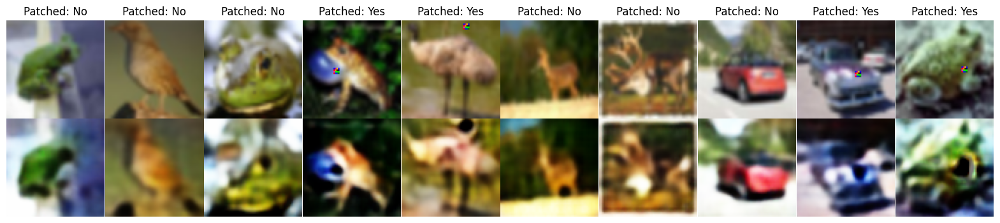

Best Anomaly Detection Accuracy: 0.98 at Threshold: 0.01


In [ ]:
# The GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Test the model for detecting the small-scale patch
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

BATCH_SIZE = 50  # Update batch size to 50
device = 'cuda' if torch.cuda.is_available() else 'cpu'

transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

transform = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor()])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

def add_adversarial_patch(images, patch_size=(4, 4), probability=0.6):
    patched_images = images.clone()
    patch = torch.randn((3, patch_size[0], patch_size[1]))
    is_patched = np.zeros(len(images), dtype=bool)
    for idx, img in enumerate(patched_images):
        if np.random.rand() < probability:
            start_x = np.random.randint(0, img.shape[2] - patch_size[1])
            start_y = np.random.randint(0, img.shape[1] - patch_size[0])
            img[:, start_y:start_y+patch_size[1], start_x:start_x+patch_size[0]] = patch
            is_patched[idx] = True
    return patched_images, is_patched

data, _ = next(iter(test_loader))
data = data.to(device)

patched_data, is_patched = add_adversarial_patch(data)

recon_batch, _, _, _, _ = model3(patched_data)

def calculate_reconstruction_error(data, recon_data):
    return F.mse_loss(recon_data, data, reduction='none').mean([1, 2, 3])

# Calculate reconstruction errors
reconstruction_errors = calculate_reconstruction_error(patched_data, recon_batch)
reconstruction_errors = reconstruction_errors.detach().cpu().numpy()

# Determine the best threshold for anomaly detection
best_accuracy = 0.0
best_threshold = 0.0
for percentile in range(0, 100):
    threshold = np.percentile(reconstruction_errors, percentile)
    predicted_anomalies = reconstruction_errors > threshold
    accuracy = (predicted_anomalies == is_patched).mean()
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_threshold = threshold

# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

# Plot the original and reconstructed images
def plot_images_with_labels(original_images, reconstructed_images, labels, n=10):
    fig, axes = plt.subplots(2, n, figsize=(20, 4))
    plt.subplots_adjust(wspace=0, hspace=0)

    for i in range(n):
        # Display original images with labels
        ax = axes[0, i]
        original_img = original_images[i].cpu().numpy()  # Move tensor to CPU
        ax.imshow(np.transpose(original_img, (1, 2, 0)))
        ax.axis('off')
        label_text = 'Yes' if labels[i] else 'No'
        ax.set_title(f"Patched: {label_text}")

        # Display reconstructed images
        ax = axes[1, i]
        recon_img = reconstructed_images[i].cpu().detach().numpy()  # Move tensor to CPU
        ax.imshow(np.transpose(recon_img, (1, 2, 0)))
        ax.axis('off')

    plt.show()

# Print whether the image was patched and the model's prediction
for i in range(50):
    actual = 'Yes' if is_patched[i] else 'No'
    predicted = 'Yes' if reconstruction_errors[i] > best_threshold else 'No'
    print(f"Image {i+1}: Patched: {actual}, Predicted: {predicted}")

# Plot images and labels for the first 10 instances
plot_images_with_labels(patched_data[:10], recon_batch[:10], is_patched[:10], n=10)
# Display results
print(f"Best Anomaly Detection Accuracy: {best_accuracy:.2f} at Threshold: {best_threshold:.2f}")

Files already downloaded and verified


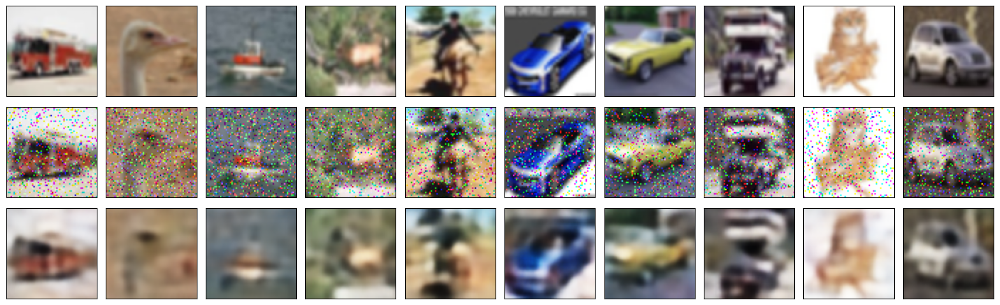

In [ ]:
# Test the reconstruction of GS-VAE model was trained by the dataset without class automobile by using parallel linear increasing temperature adjustment framework (using different changing rate with model 1)
# The original images are attacked by high-intensity s&p noise
from skimage.util import random_noise
import torch
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader
from torchvision import datasets, transforms


def plot_images(original_images, noisy_images, reconstructed_noisy_images, n=10):
    plt.figure(figsize=(n * 2, 6))
    for i in range(n):
        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

        ax = plt.subplot(3, n, i + 1 + 2 * n)
        plt.imshow(reconstructed_noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()


transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
test_loader = DataLoader(test_dataset, shuffle=True, batch_size=10, num_workers=4, pin_memory=True)


SAVE_PATH = "/content/model.pth"
model.load_state_dict(torch.load(SAVE_PATH, map_location=device))
model.to(device)
model.eval()

data, _ = next(iter(test_loader))
data = data.to(device)

original_images = data.cpu().numpy()

noisy_images = random_noise(original_images, mode="s&p", amount=0.1)

noisy_data_tensor = torch.tensor(noisy_images, dtype=torch.float32).to(device)
with torch.no_grad():
    recon_noisy_batch, _, _ = model(noisy_data_tensor)

plot_images(original_images, noisy_images, recon_noisy_batch.cpu().numpy(), n=10)



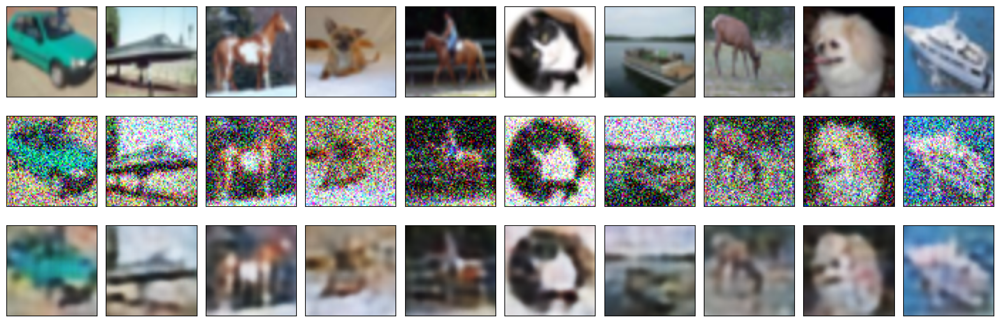

In [ ]:
# Test the reconstruction of GS-VAE model was trained by the dataset without class automobile by using parallel linear increasing temperature adjustment framework (using different changing rate with model 1)
# The original images are attacked by high-intensity Gaussian noise
import torch
import matplotlib.pyplot as plt
import numpy as np

def add_gaussian_noise(images, mean=0.0, std=0.3):
    noise = np.random.normal(mean, std, images.shape)
    noisy_images = images + noise
    return np.clip(noisy_images, 0, 1)

def plot_images(original_images, noisy_images, reconstructed_noisy_images, n=10):
    plt.figure(figsize=(n * 2, 6.5))
    for i in range(n):

        ax = plt.subplot(3, n, i + 1)
        plt.imshow(original_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


        ax = plt.subplot(3, n, i + 1 + n)
        plt.imshow(noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)


        ax = plt.subplot(3, n, i + 1 + 2 * n)
        plt.imshow(reconstructed_noisy_images[i].transpose(1, 2, 0))
        ax.get_xaxis().set_visible(False)
        ax.get_yaxis().set_visible(False)

    plt.subplots_adjust(wspace=0.1, hspace=0.1)
    plt.show()


noisy_data = add_gaussian_noise(data.cpu().numpy())

noisy_data_tensor = torch.tensor(noisy_data).float().to(device)
model.eval()
with torch.no_grad():
    recon_noisy_batch, _, _ = model(noisy_data_tensor)

plot_images(data.cpu().numpy(), noisy_data, recon_noisy_batch.cpu().numpy(), n=10)


In [ ]:
# Train a CNN to classify the CIFAR-10
# The CNN can be used to classify the reconstructed images generated by our model (Original images are attacked by adversarial attacks)
import torch
import torch.nn as nn
import torch.optim as optim
from torchvision import datasets, transforms
from torch.utils.data import DataLoader

transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

train_dataset = datasets.CIFAR10('./data', train=True, transform=transform, download=True)
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)

BATCH_SIZE = 64
train_loader = DataLoader(train_dataset, shuffle=True, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)
test_loader = DataLoader(test_dataset, shuffle=False, batch_size=BATCH_SIZE, num_workers=4, pin_memory=True)

# Define the model
num_classes = 10

model = nn.Sequential(
    nn.Conv2d(3, 32, (3, 3), padding=1),
    nn.ReLU(),
    nn.BatchNorm2d(32),
    nn.Conv2d(32, 32, (3, 3), padding=1),
    nn.ReLU(),
    nn.BatchNorm2d(32),
    nn.MaxPool2d((2, 2)),
    nn.Dropout(0.3),

    nn.Conv2d(32, 64, (3, 3), padding=1),
    nn.ReLU(),
    nn.BatchNorm2d(64),
    nn.Conv2d(64, 64, (3, 3), padding=1),
    nn.ReLU(),
    nn.BatchNorm2d(64),
    nn.MaxPool2d((2, 2)),
    nn.Dropout(0.5),

    nn.Conv2d(64, 128, (3, 3), padding=1),
    nn.ReLU(),
    nn.BatchNorm2d(128),
    nn.Conv2d(128, 128, (3, 3), padding=1),
    nn.ReLU(),
    nn.BatchNorm2d(128),
    nn.MaxPool2d((2, 2)),
    nn.Dropout(0.5),

    nn.Flatten(),
    nn.Linear(128 * 8 * 8, 128),
    nn.ReLU(),
    nn.BatchNorm1d(128),
    nn.Dropout(0.5),
    nn.Linear(128, num_classes)
)

# Create an instance of the custom model
cnn_model = CustomCNN(num_classes)

# Define loss function and optimizer
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(cnn_model.parameters(), lr=0.001)

# Training loop
num_epochs = 60  # Define the number of epochs
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
cnn_model.to(device)  # Make sure to send the model to the device

best_accuracy = 0.0
best_model_state = None

def evaluate_model(model, test_loader, device):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for inputs, labels in test_loader:
            inputs, labels = inputs.to(device), labels.to(device)
            outputs = model(inputs)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total


for epoch in range(num_epochs):
    cnn_model.train()  # Use cnn_model
    running_loss = 0.0
    for inputs, labels in train_loader:
        inputs, labels = inputs.to(device), labels.to(device)

        optimizer.zero_grad()
        outputs = cnn_model(inputs)  # Use cnn_model
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item()

    # Evaluate the model
    accuracy = evaluate_model(cnn_model, test_loader, device)
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {running_loss / len(train_loader)}, Accuracy: {accuracy}%")

    # Save the best model
    if accuracy > best_accuracy:
        best_accuracy = accuracy
        best_model_state = cnn_model.state_dict()

# Save the best model outside the training loop
if best_model_state is not None:
    torch.save(best_model_state, 'best_trainedCifarCNN_model.pth')
    print("Best model saved with accuracy:", best_accuracy)


Files already downloaded and verified
Files already downloaded and verified
Epoch 1/60, Loss: 1.1743043751058067, Accuracy: 70.05%
Epoch 2/60, Loss: 0.6765837932334227, Accuracy: 76.8%
Epoch 3/60, Loss: 0.5032406047634457, Accuracy: 77.16%
Epoch 4/60, Loss: 0.3853445573212088, Accuracy: 82.59%
Epoch 5/60, Loss: 0.24154785365971457, Accuracy: 83.59%
Epoch 6/60, Loss: 0.1533930292281577, Accuracy: 83.27%
Epoch 7/60, Loss: 0.10560006635916203, Accuracy: 84.11%
Epoch 8/60, Loss: 0.09058901863267926, Accuracy: 83.8%
Epoch 9/60, Loss: 0.06341542538834255, Accuracy: 84.61%
Epoch 10/60, Loss: 0.056103496721474085, Accuracy: 82.53%
Epoch 11/60, Loss: 0.06666286413104075, Accuracy: 84.62%
Epoch 12/60, Loss: 0.04222722231756414, Accuracy: 83.99%
Epoch 13/60, Loss: 0.04341194305940808, Accuracy: 84.31%
Epoch 14/60, Loss: 0.07197601596861744, Accuracy: 85.13%
Epoch 15/60, Loss: 0.020736325330369215, Accuracy: 85.64%
Epoch 16/60, Loss: 0.025671523107714322, Accuracy: 82.96%
Epoch 17/60, Loss: 0.0391

In [ ]:
# Load the saved CNN model weights
cnn_model.load_state_dict(torch.load('/content/sample_data/trainedCifarCNN_model.pth'))
cnn_model.eval()  # Set the model to evaluation mode
correct = 0
total = 0
with torch.no_grad():
    for inputs, labels in test_loader:
        inputs, labels = inputs.to(device), labels.to(device)
        outputs = cnn_model(inputs)
        _, predicted = torch.max(outputs, 1)
        total += labels.size(0)
        correct += (predicted == labels).sum().item()

accuracy = 100 * correct / total
print(f"Test Accuracy: {accuracy:.2f}%")

Test Accuracy: 86.69%


In [ ]:
# Test the GS-VAE model was trained by full dataset by using parallel temperature adjustment framework
# Using the trained CNN to classify the reconstructed images generated by our model
import torch
from torchvision import datasets, transforms
from torch.utils.data import DataLoader, TensorDataset, Subset
import numpy as np
import torch.nn.functional as F


BATCH_SIZE = 64
device = 'cuda' if torch.cuda.is_available() else 'cpu'

# Define the transformation
transform = transforms.Compose([
    transforms.Resize((64, 64)),
    transforms.ToTensor()
])

# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = Subset(test_dataset, non_class_1_indices)
non_class_1_loader = DataLoader(non_class_1_dataset, batch_size=BATCH_SIZE, shuffle=True)

model.to(device).eval()
model1.to(device).eval()
model3.to(device).eval()

cnn_model.load_state_dict(torch.load('/content/best_trainedCifarCNN_model.pth'))
cnn_model.eval()

def create_recon_loader(recon_batch, original_labels):
    recon_images = recon_batch.cpu()
    recon_dataset = TensorDataset(recon_images, original_labels)
    return DataLoader(recon_dataset, batch_size=BATCH_SIZE, shuffle=False)

def calculate_accuracy(model, loader):
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in loader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return 100 * correct / total

# Function for the PGD attack
def pgd_attack(model, images, labels, eps, alpha, iters):
    images = images.clone().detach().to(device).requires_grad_(True)
    labels = labels.clone().detach().to(device)
    original_images = images.clone().detach()

    for _ in range(iters):
        outputs = model(images)
        loss = F.cross_entropy(outputs, labels)
        model.zero_grad()
        loss.backward()
        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - original_images, min=-eps, max=eps)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad_(True)

    return images


def main():
    # Get a batch of data
    data, original_labels = next(iter(non_class_1_loader))
    data = data.to(device)
    original_labels = original_labels.to(device)

    # Perform PGD attack
    eps = 0.3 # intensity is 0.3
    alpha = 0.01
    iters = 40
    attacked_data = pgd_attack(cnn_model, data, original_labels, eps, alpha, iters)

    # Process images through each reconstruction model
    with torch.no_grad():
        recon_batch_model = model(attacked_data)[0]
        recon_batch_model1 = model1(attacked_data)[0]
        recon_batch_model3 = model3(attacked_data)[0]

    # Create data loaders for the reconstructed images
    recon_loader_model = create_recon_loader(recon_batch_model, original_labels)
    recon_loader_model1 = create_recon_loader(recon_batch_model1, original_labels)
    recon_loader_model3 = create_recon_loader(recon_batch_model3, original_labels)

    # Calculate accuracies
    accuracy_model = calculate_accuracy(cnn_model, recon_loader_model)
    accuracy_model1 = calculate_accuracy(cnn_model, recon_loader_model1)
    accuracy_model3 = calculate_accuracy(cnn_model, recon_loader_model3)

    # Print accuracies
    print(f'Accuracy for reconstructed images by model: {accuracy_model:.2f}%')
    print(f'Accuracy for reconstructed images by model1: {accuracy_model1:.2f}%') # the GS-VAE model was trained by the dataset without class "automobile" by using parallel temperature adjustment framework
    print(f'Accuracy for reconstructed images by model2: {accuracy_model3:.2f}%') # the GS-VAE model was trained by full dataset by using parallel temperature adjustment framework

if __name__ == '__main__':
    main()


Files already downloaded and verified
Accuracy for reconstructed images by model: 43.75%
Accuracy for reconstructed images by model1: 43.75%
Accuracy for reconstructed images by model2: 60.94%


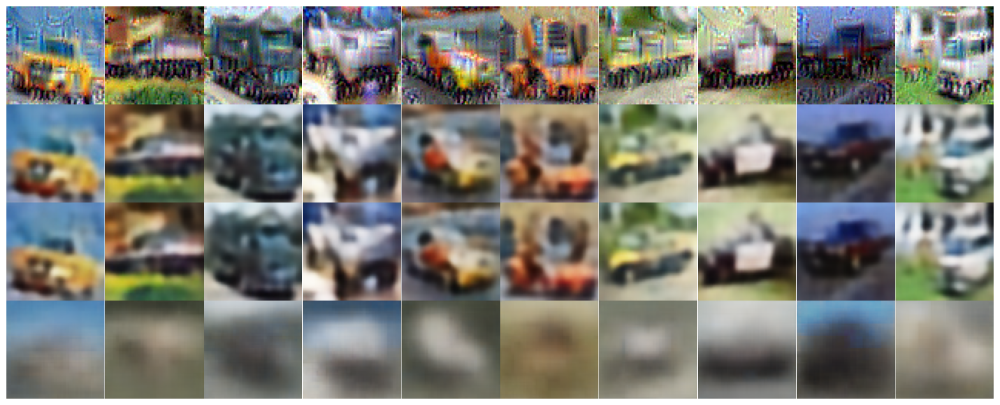

In [ ]:
# Test the models for reconstructing the class 1's images attacked by high-intensity PGD attacks
# In this cell, all the models are trained by the dataset without class 1 (automobile)
import matplotlib.pyplot as plt
from torch.utils.data import DataLoader, Subset
from torchvision import datasets, transforms
import numpy as np
import torch
import torch.nn.functional as F


# Function for the PGD attack
def pgd_attack(model, images, labels, eps, alpha, iters):
    images = images.clone().detach().to(device).requires_grad_(True)
    labels = labels.clone().detach().to(device)
    original_images = images.clone().detach()

    for _ in range(iters):
        outputs = model(images)
        loss = F.cross_entropy(outputs, labels)
        model.zero_grad()
        loss.backward()
        adv_images = images + alpha*images.grad.sign()
        eta = torch.clamp(adv_images - original_images, min=-eps, max=eps)
        images = torch.clamp(original_images + eta, min=0, max=1).detach_()
        images.requires_grad_(True)

    return images

# Define a function to plot images for comparison
def plot_comparison(original_images, recon_images_model, recon_images_model1, recon_images_model2, n=10):
    fig, axes = plt.subplots(4, n, figsize=(20, 8))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        axes[0, i].imshow(np.transpose(original_images[i], (1, 2, 0)))
        axes[0, i].axis('off')  # Hide axes

        # Display reconstructed images from model
        axes[1, i].imshow(np.transpose(recon_images_model[i], (1, 2, 0)))
        axes[1, i].axis('off')  # Hide axes

        # Display reconstructed images from model1
        axes[2, i].imshow(np.transpose(recon_images_model1[i], (1, 2, 0)))
        axes[2, i].axis('off')  # Hide axes

        # Display reconstructed images from model2
        axes[3, i].imshow(np.transpose(recon_images_model2[i], (1, 2, 0)))
        axes[3, i].axis('off')  # Hide axes
    plt.show()

# Set up the data loader
class_1_loader = DataLoader(class_1_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=4, pin_memory=True)

# Perform the attack and reconstruction
data, labels = next(iter(class_1_loader))
data = data.to(device)
labels = labels.to(device)

# Apply PGD attack
eps = 0.3
alpha = 0.01
iters = 40
attacked_data = pgd_attack(cnn_model, data, labels, eps, alpha, iters)

# Pass the attacked images through each model
with torch.no_grad():
    recon_batch_model = model(attacked_data)[0]
    recon_batch_model1 = model1(attacked_data)[0]
    recon_batch_model2 = model2(attacked_data)[0]

# Plot the original (attacked) and reconstructed images
# Plot the original (attacked) and reconstructed images
original_images = attacked_data.detach().cpu().numpy()
recon_images_model = recon_batch_model.detach().cpu().numpy()
recon_images_model1 = recon_batch_model1.detach().cpu().numpy()
recon_images_model2 = recon_batch_model2.detach().cpu().numpy()

# Call the plotting function
plot_comparison(original_images, recon_images_model, recon_images_model1, recon_images_model2, n=10)


Files already downloaded and verified


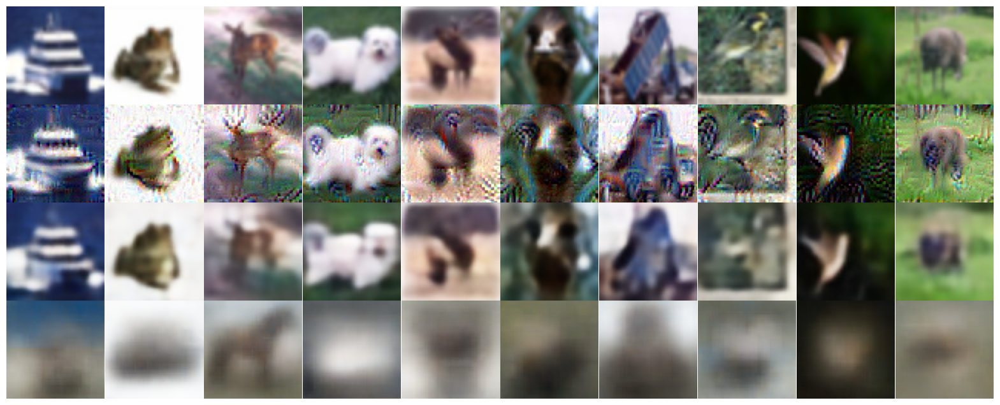

In [ ]:
# Test the models for reconstructing the images attacked by high-intensity PGD attacks
# In this cell, all the models are trained by the dataset without class 1 (automobile)
import matplotlib.pyplot as plt
import numpy as np

# Define a function to plot images for comparison
def plot_comparison(original_images, attacked_images, recon_images_model1, recon_images_model2, n=15):
    fig, axes = plt.subplots(4, n, figsize=(20, 8))
    plt.subplots_adjust(wspace=0, hspace=0)  # Remove spaces between subplots
    for i in range(n):
        # Display original images
        axes[0, i].imshow(np.transpose(original_images[i], (1, 2, 0)))
        axes[0, i].axis('off')  # Hide axes

        # Display attacked images
        axes[1, i].imshow(np.transpose(attacked_images[i], (1, 2, 0)))
        axes[1, i].axis('off')  # Hide axes

        # Display reconstructed images from model1
        axes[2, i].imshow(np.transpose(recon_images_model1[i], (1, 2, 0)))
        axes[2, i].axis('off')  # Hide axes

        # Display reconstructed images from model2
        axes[3, i].imshow(np.transpose(recon_images_model2[i], (1, 2, 0)))
        axes[3, i].axis('off')  # Hide axes
    plt.show()


# Download and load the CIFAR-10 test dataset
test_dataset = datasets.CIFAR10('./data', train=False, transform=transform, download=True)
non_class_1_indices = [i for i, (_, label) in enumerate(test_dataset) if label != 1]
non_class_1_dataset = DataLoader(Subset(test_dataset, non_class_1_indices), batch_size=BATCH_SIZE, shuffle=True)

# Perform the attack and reconstruction
data, labels = next(iter(non_class_1_dataset))
data = data.to(device)
labels = labels.to(device)

# Apply PGD attack to the original images
attacked_data = pgd_attack(cnn_model, data, original_labels, eps, alpha, iters)

# Pass the attacked images through each model
with torch.no_grad():
    recon_batch_model1 = model1(attacked_data)[0]
    recon_batch_model2 = model2(attacked_data)[0]

# Prepare the images for plotting
original_images = data.detach().cpu().numpy()
attacked_images = attacked_data.detach().cpu().numpy()
recon_images_model1 = recon_batch_model1.detach().cpu().numpy()
recon_images_model2 = recon_batch_model2.detach().cpu().numpy()

# Call the plotting function
plot_comparison(original_images, attacked_images, recon_images_model1, recon_images_model2, n=10)
